# Splice Box MIITS analysis for RRR = 131

Imports

In [1]:
import numpy as _np
from matplotlib import pyplot as _plt
import quench as _quench
import detection as _detection
import materials as _materials

### Analysis parameters

In [2]:
# Splice Box detection section
Tc = 9.2
Tcs = 6.1 # not used in calculation
# Wire measured by SUP
s_cu = 2.76144e-7
s_nbti = 2.99794e-7
s_insulator = 0
RRR = 131
t_valid = 0.04
t_act = 0.012
ps_delay = 0.07 # seg
max_ps_voltage = 10 # V
V_fw_diode = 0.0 # freewheeling diode fwd voltage
Bmax = 0.001 # T
L_cte = 0.001 # H
L_I = {
    0 : L_cte,
    300 : L_cte
}

# Simulation scenarios
scenario_Iop_low_resolution = [1, 10]
scenario_Iop_high_resolution = [50, 100, 228, 300]
scenario_Iop = scenario_Iop_low_resolution + scenario_Iop_high_resolution
scenario_Rdump = [1]
scenario_Top = [4.2, 5]
scenario_B = [Bmax]
scenario_vdet = [0.01, 0.1] # V

### Required wire size for quench detection

In [3]:
dict_scwire = {}
dict_scwire['Iop'] = scenario_Iop[0]
dict_scwire['B'] = Bmax
dict_scwire['Top'] = scenario_Top[0]
dict_scwire['Tc'] = Tc
dict_scwire['Tcs'] = Tcs
dict_scwire['RRR'] = RRR
dict_scwire['ratio_cu_sc'] = s_cu/s_nbti
dict_scwire['d_cond'] = 8.5633e-4
dict_scwire['L'] = L_I

counter = 0
scwire = _materials.SCWire(dict_scwire)
for Iop in scenario_Iop:
    for B in scenario_B:
        for Top in scenario_Top:
            for vdet in scenario_vdet:
                print('counter={}'.format(counter))
                counter += 1
                Jo = Iop/_np.add(s_cu, s_nbti)
                Jo_mm2 = Jo*1e-6
                Tcs = scwire.calc_current_sharing_temp(Jo_mm2, B)
                Tjoule = _np.divide(_np.add(Tc, Tcs), 2)
                if Top >= Tcs:
                    raise ValueError('Tcs cannot be smaller than Top')
                C_avg = _quench.composite_vol_specific_heat_sc(
                    s_cu, s_nbti, Tjoule, Top, B
                )
                rho = _quench.composite_resistivity(
                    Tjoule, s_cu, s_nbti, RRR, B,
                    is_sc=False, use_magnetoresist=True
                )
                k_avg=_quench.composite_thermal_conductivity(
                    copper_area=s_cu, nbti_area=s_nbti, T2=Tjoule,
                    T1=Top, RRR=RRR
                )
                vq = _detection.calc_prop_velocity(
                    Jo=Jo, C=C_avg, rho=rho, k=k_avg, Tjoule=Tjoule,
                    Top=Top, method='adiabatic'
                )
                t_det = _detection.calc_detection_time(
                    vq, rho, vdet=vdet, Io=Iop, Acu=s_cu
                )
                print("Iop={}, B={}, Top={}: vq={} m/s, v_det={} V, t_det={} sec, wire_size={} m".format(Iop, B, Top, vq, vdet, t_det, vq*t_det))

counter=0
Iop=1, B=0.001, Top=4.2: vq=0.03063857094650083 m/s, v_det=0.01 V, t_det=365.5907292425486 sec, wire_size=11.2011774952808 m
counter=1
Iop=1, B=0.001, Top=4.2: vq=0.03063857094650083 m/s, v_det=0.1 V, t_det=3655.9072924254865 sec, wire_size=112.01177495280803 m
counter=2
Iop=1, B=0.001, Top=5: vq=0.030376087338353428 m/s, v_det=0.01 V, t_det=368.7498449195588 sec, wire_size=11.2011774952808 m
counter=3
Iop=1, B=0.001, Top=5: vq=0.030376087338353428 m/s, v_det=0.1 V, t_det=3687.4984491955884 sec, wire_size=112.01177495280801 m
counter=4
Iop=10, B=0.001, Top=4.2: vq=0.30638570946500826 m/s, v_det=0.01 V, t_det=3.6559072924254865 sec, wire_size=1.12011774952808 m
counter=5
Iop=10, B=0.001, Top=4.2: vq=0.30638570946500826 m/s, v_det=0.1 V, t_det=36.55907292425486 sec, wire_size=11.2011774952808 m
counter=6
Iop=10, B=0.001, Top=5: vq=0.30376087338353425 m/s, v_det=0.01 V, t_det=3.687498449195589 sec, wire_size=1.12011774952808 m
counter=7
Iop=10, B=0.001, Top=5: vq=0.3037608733835

### MIITS Analysis

In [4]:
hot_spot_results = []
counter = 0
# Hot-spot by MIITS
for Iop in scenario_Iop:
    for B in scenario_B:
        for Rdump in scenario_Rdump:
            for Top in scenario_Top:
                for vdet in scenario_vdet:
                    print('counter={}'.format(counter))
                    counter += 1
                    Jo = Iop/_np.add(s_cu, s_nbti)
                    Jo_mm2 = Jo*1e-6
                    Tcs = scwire.calc_current_sharing_temp(Jo_mm2, B)
                    Tjoule = _np.divide(_np.add(Tc, Tcs), 2)
                    if Top >= Tcs:
                        raise ValueError('Tcs cannot be smaller than Top')
                    # calculate average heat capacity
                    C_avg = _quench.composite_vol_specific_heat_sc(
                        s_cu, s_nbti, Tjoule, Top, B
                    )
                    rho = _quench.composite_resistivity(
                        Tjoule, s_cu, s_nbti, RRR, B,
                        is_sc=False, use_magnetoresist=True
                    )
                    k_avg=_quench.composite_thermal_conductivity(
                        copper_area=s_cu, nbti_area=s_nbti, T2=Tjoule,
                        T1=Top, RRR=RRR
                        )
                    vq = _detection.calc_prop_velocity(
                        Jo=Jo, C=C_avg, rho=rho, k=k_avg, Tjoule=Tjoule,
                        Top=Top, method='adiabatic'
                        )
                    t_det = _detection.calc_detection_time(
                        vq, rho, vdet=vdet, Io=Iop, Acu=s_cu
                        )
                    t_switch = t_det + t_valid + t_act
                    t_max = _quench.calc_hot_spot(
                        copper_area=s_cu,
                        nbti_area=s_nbti,
                        I_op=Iop,
                        tau=L_cte/Rdump,
                        t_switch=t_switch,
                        RRR=RRR,
                        B=B,
                        )
                    hot_spot_results.append((Iop, B, Rdump, Top, vdet, C_avg, rho, k_avg, vq, t_switch, t_max))

# print hot-spot results
print(hot_spot_results)


counter=0
counter=1
counter=2
counter=3
counter=4
counter=5
counter=6
counter=7
counter=8
counter=9
counter=10
counter=11
counter=12
counter=13
counter=14
counter=15
counter=16
counter=17
counter=18
counter=19
counter=20
counter=21
counter=22
counter=23
[(1, 0.001, 1, 4.2, 0.01, 10395.367383982326, 2.4653122416490855e-10, 675.6183384943887, 0.03063857094650083, 365.6427292425486, 15.999999999999957), (1, 0.001, 1, 4.2, 0.1, 10395.367383982326, 2.4653122416490855e-10, 675.6183384943887, 0.03063857094650083, 3655.9592924254866, 32.2999999999999), (1, 0.001, 1, 5, 0.01, 11784.355603523121, 2.4653122416490855e-10, 715.4890251526139, 0.030376087338353428, 368.80184491955885, 16.09999999999996), (1, 0.001, 1, 5, 0.1, 11784.355603523121, 2.4653122416490855e-10, 715.4890251526139, 0.030376087338353428, 3687.5504491955885, 32.3999999999999), (10, 0.001, 1, 4.2, 0.01, 10395.367383982326, 2.4653122416490855e-10, 675.6183384943887, 0.30638570946500826, 3.7079072924254866, 16.09999999999996), (10, 

### Wilson Analysis with high resolution

In [5]:
results_high_resolution = []

# Wilson simulation parameters
time_step_1 = 0.00001
time_step_2 = 0.001
t_switch_time_step = 0.005
alpha = 0.03
use_magnetoresist=True
geometry = 'line'
curr_tol = 0.01
short_wire_length = 3e-1 # m
long_wire_length = 1 # m
magnet_vol_list = [short_wire_length * (s_cu + s_nbti), long_wire_length * (s_cu + s_nbti)]

for Iop in scenario_Iop_high_resolution:
    for B in scenario_B:
        for Rdump in scenario_Rdump:
            for Top in scenario_Top:
                for magnet_vol in magnet_vol_list:
                    for vdet in scenario_vdet:
                        Jo = Iop/_np.add(s_cu, s_nbti)
                        Jo_mm2 = Jo*1e-6
                        Tcs = scwire.calc_current_sharing_temp(Jo_mm2, B)
                        # Wilson simulation
                        [
                            R, I, Vq, Ve, Vc, Vl, Vnz, Eq, Eps, Tmax, Tavg,
                            final_zone_transv_radius, final_zone_long_radius,
                            time_axis, iter_cnt
                        ] = _quench.simple_quench_propagation(
                            I_op=Iop, T_cs=Tcs, T_op=Top,
                            copper_area=s_cu, nbti_area=s_nbti, insulator_area=s_insulator,
                            inductanceI=L_I, magnet_vol=magnet_vol, t_valid=t_valid,
                            t_act=t_act, det_tresh=vdet, R_dump=Rdump,
                            time_step_1=time_step_1, time_step_2=time_step_2,
                            switch_time_step=t_switch_time_step, RRR=RRR, B=B,
                            alpha=alpha, tolerance=curr_tol, geometry=geometry,
                            V_ps_max = max_ps_voltage, t_ps=ps_delay,
                            V_fw_diode=V_fw_diode, use_magnetoresist=use_magnetoresist,
                            print_results=False, end_time=10, end_temp=110
                            )
                        results_high_resolution.append({
                        'R' : R, 'I' : I, 'Vq' : Vq, 'Ve' : Ve, 'Vc' : Vc, 'Vl' : Vl,
                        'Vnz' : Vnz, 'Eq' : Eq, 'Eps' : Eps, 'Tmax' : Tmax, 'Tavg' : Tavg,
                        'final_zone_transv_radius' : final_zone_transv_radius,
                        'final_zone_long_radius' : final_zone_long_radius,
                        'time_axis' : time_axis, 'iter_cnt' : iter_cnt,
                        'Iop' : Iop, 'B' : B, 'Rdump' : Rdump, 'Top' : Top, 'wire_length' : magnet_vol / (s_cu + s_nbti),
                        'vdet' : vdet
                    })

num iter = 1
max temp = 9.119866921556925
Iop = 50.0


num iter = 2
max temp = 9.121165842446741
Iop = 50.0


num iter = 3
max temp = 9.122464347604408
Iop = 50.0


num iter = 4
max temp = 9.123762437358078
Iop = 50.0


num iter = 5
max temp = 9.125060112035484
Iop = 50.0


num iter = 6
max temp = 9.12635737196394
Iop = 50.0


num iter = 7
max temp = 9.12765421747034
Iop = 50.0


num iter = 8
max temp = 9.128950648881164
Iop = 50.0


num iter = 9
max temp = 9.130246666522469
Iop = 50.0


num iter = 10
max temp = 9.131542270719903
Iop = 50.0


num iter = 11
max temp = 9.132837461798694
Iop = 50.0


num iter = 12
max temp = 9.134132240083655
Iop = 50.0


num iter = 13
max temp = 9.135426605899188
Iop = 50.0


num iter = 14
max temp = 9.136720559569277
Iop = 50.0


num iter = 15
max temp = 9.138014101417498
Iop = 50.0


num iter = 16
max temp = 9.139307231767013
Iop = 50.0


num iter = 17
max temp = 9.140599950940574
Iop = 50.0


num iter = 18
max temp = 9.141892259260523
Iop = 50.0


num

### Wilson Analysis with low resolution

In [6]:
results_low_resolution = []

# Wilson simulation parameters
time_step_1 = 0.001
time_step_2 = 0.1
t_switch_time_step = 0.05

for Iop in scenario_Iop_low_resolution:
    for B in scenario_B:
        for Rdump in scenario_Rdump:
            for Top in scenario_Top:
                for magnet_vol in magnet_vol_list:
                    for vdet in scenario_vdet:
                        Jo = Iop/_np.add(s_cu, s_nbti)
                        Jo_mm2 = Jo*1e-6
                        Tcs = scwire.calc_current_sharing_temp(Jo_mm2, B)
                        # Wilson simulation
                        [
                            R, I, Vq, Ve, Vc, Vl, Vnz, Eq, Eps, Tmax, Tavg,
                            final_zone_transv_radius, final_zone_long_radius,
                            time_axis, iter_cnt
                        ] = _quench.simple_quench_propagation(
                            I_op=Iop, T_cs=Tcs, T_op=Top,
                            copper_area=s_cu, nbti_area=s_nbti, insulator_area=s_insulator,
                            inductanceI=L_I, magnet_vol=magnet_vol, t_valid=t_valid,
                            t_act=t_act, det_tresh=vdet, R_dump=Rdump,
                            time_step_1=time_step_1, time_step_2=time_step_2,
                            switch_time_step=t_switch_time_step, RRR=RRR, B=B,
                            alpha=alpha, tolerance=curr_tol, geometry=geometry,
                            V_ps_max = max_ps_voltage, t_ps=ps_delay,
                            V_fw_diode=V_fw_diode, use_magnetoresist=use_magnetoresist,
                            print_results=False, end_time=3600, end_temp=110
                            )
                        results_low_resolution.append({
                        'R' : R, 'I' : I, 'Vq' : Vq, 'Ve' : Ve, 'Vc' : Vc, 'Vl' : Vl,
                        'Vnz' : Vnz, 'Eq' : Eq, 'Eps' : Eps, 'Tmax' : Tmax, 'Tavg' : Tavg,
                        'final_zone_transv_radius' : final_zone_transv_radius,
                        'final_zone_long_radius' : final_zone_long_radius,
                        'time_axis' : time_axis, 'iter_cnt' : iter_cnt,
                        'Iop' : Iop, 'B' : B, 'Rdump' : Rdump, 'Top' : Top, 'wire_length' : magnet_vol / (s_cu + s_nbti),
                        'vdet' : vdet
                    })

num iter = 1
max temp = 9.150051573061369
Iop = 1.0


num iter = 2
max temp = 9.150103145469473
Iop = 1.0


num iter = 3
max temp = 9.150154717224332
Iop = 1.0


num iter = 4
max temp = 9.150206288325966
Iop = 1.0


num iter = 5
max temp = 9.150257858774397
Iop = 1.0


num iter = 6
max temp = 9.150309428569644
Iop = 1.0


num iter = 7
max temp = 9.150360997711728
Iop = 1.0


num iter = 8
max temp = 9.150412566200668
Iop = 1.0


num iter = 9
max temp = 9.150464134036486
Iop = 1.0


num iter = 10
max temp = 9.150515701219202
Iop = 1.0


num iter = 11
max temp = 9.150567267748835
Iop = 1.0


num iter = 12
max temp = 9.150618833625407
Iop = 1.0


num iter = 13
max temp = 9.150670398848938
Iop = 1.0


num iter = 14
max temp = 9.150721963419448
Iop = 1.0


num iter = 15
max temp = 9.150773527336959
Iop = 1.0


num iter = 16
max temp = 9.15082509060149
Iop = 1.0


num iter = 17
max temp = 9.15087665321306
Iop = 1.0


num iter = 18
max temp = 9.150928215171692
Iop = 1.0


num iter = 19
max tem

#### Plot hot-spot temperature for different Splice box test specifications

************ HIGH RESOLUTION Simulation Results ************


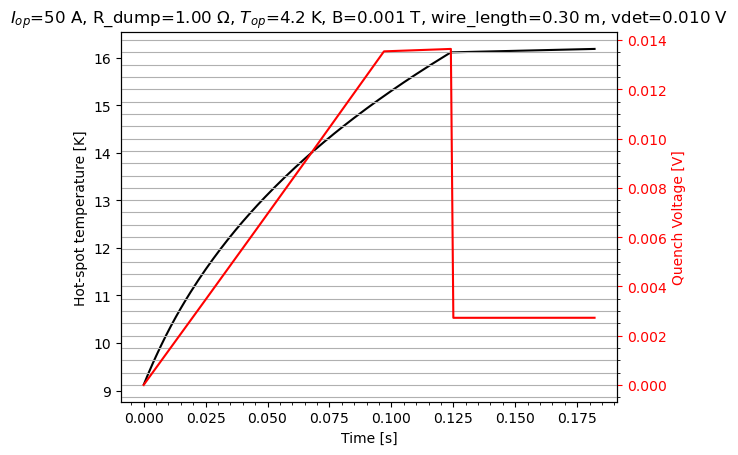

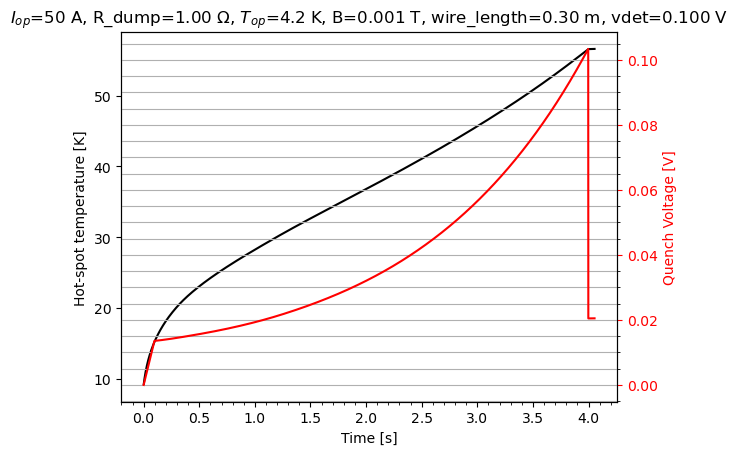

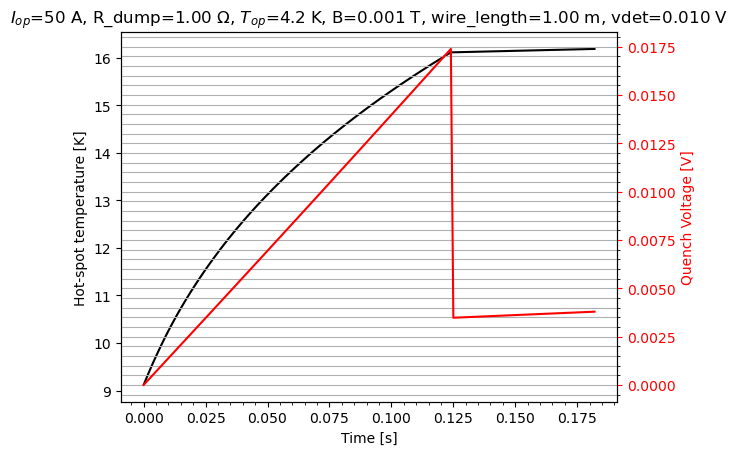

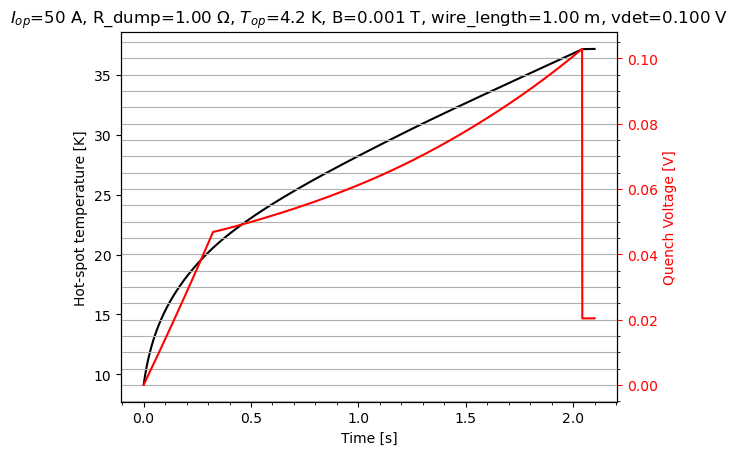

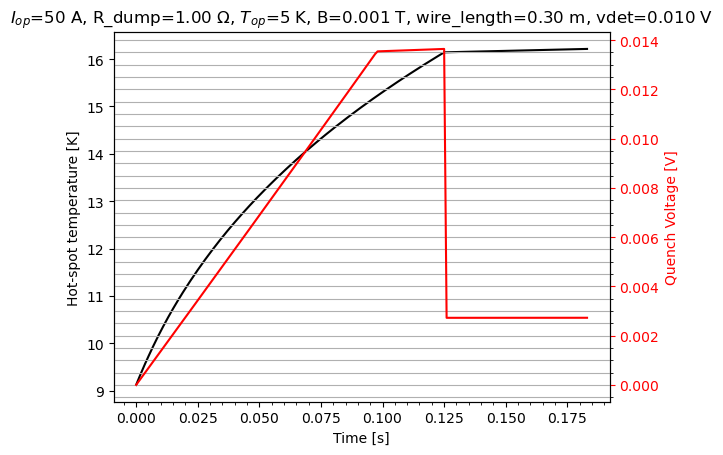

...

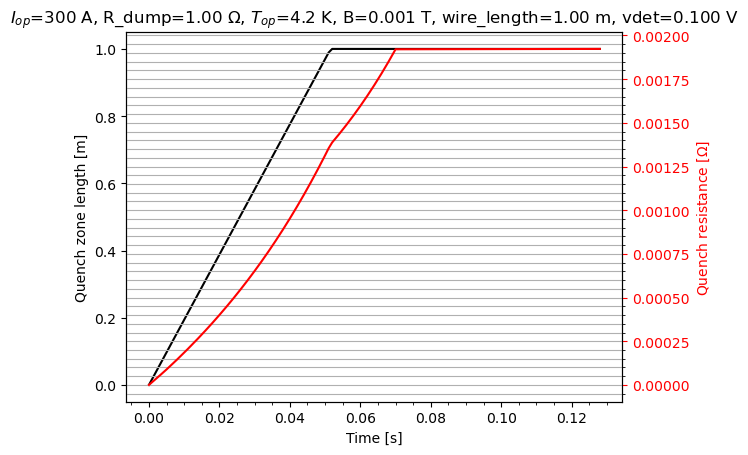

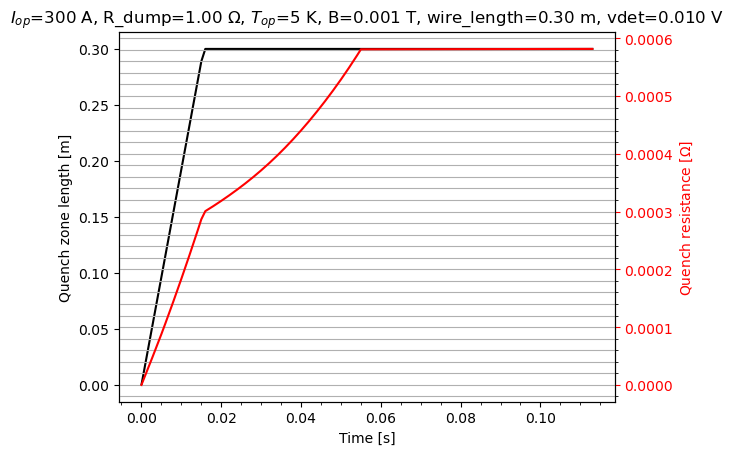

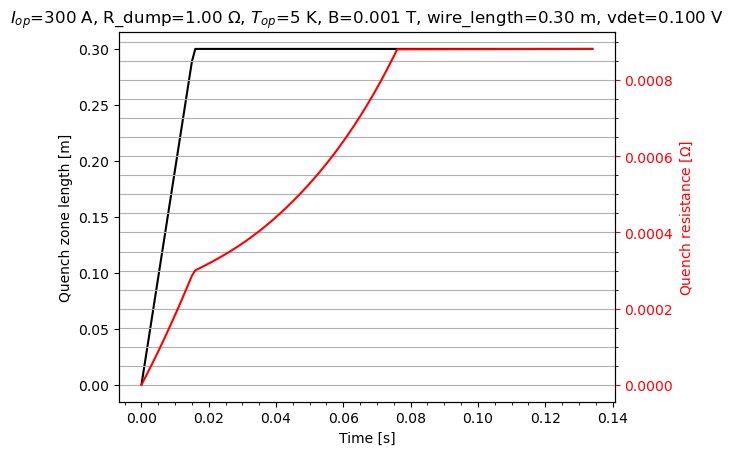

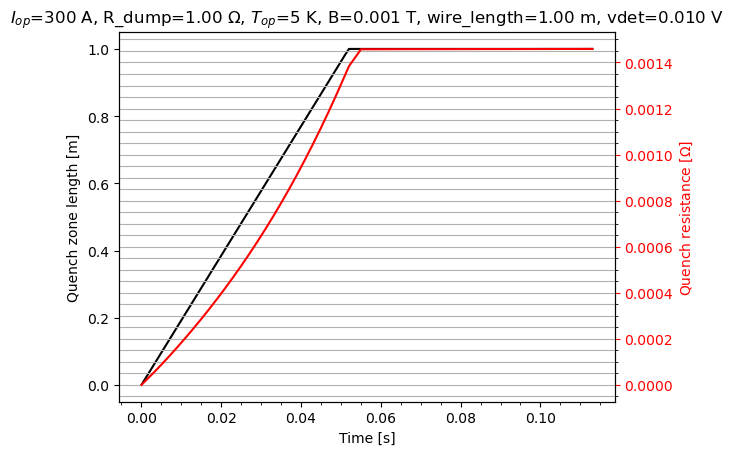

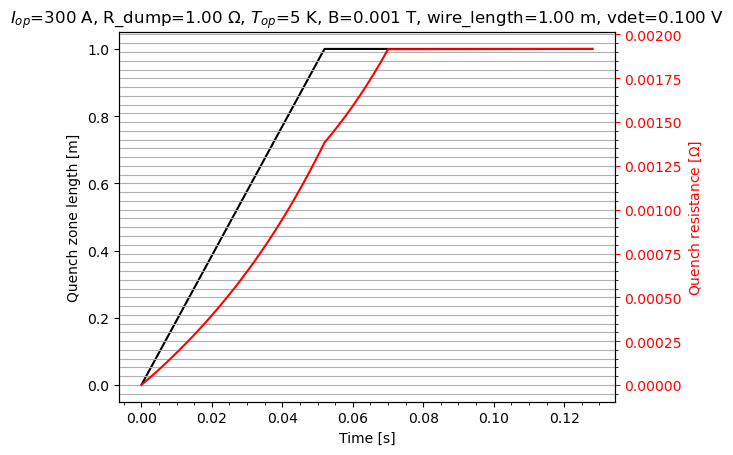

************ LOW RESOLUTION Simulation Results ************


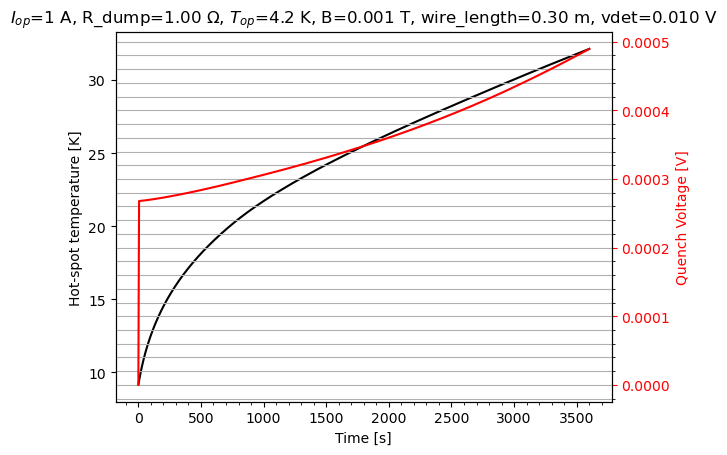

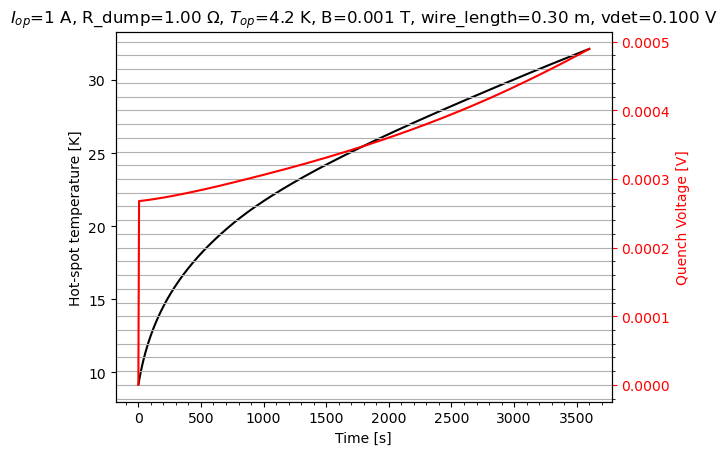

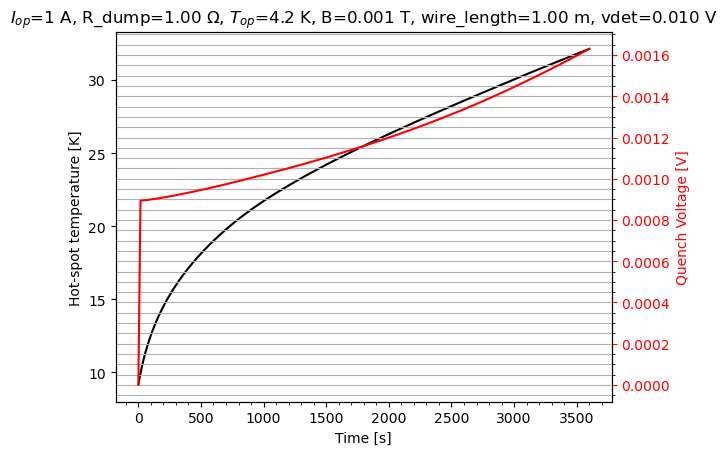

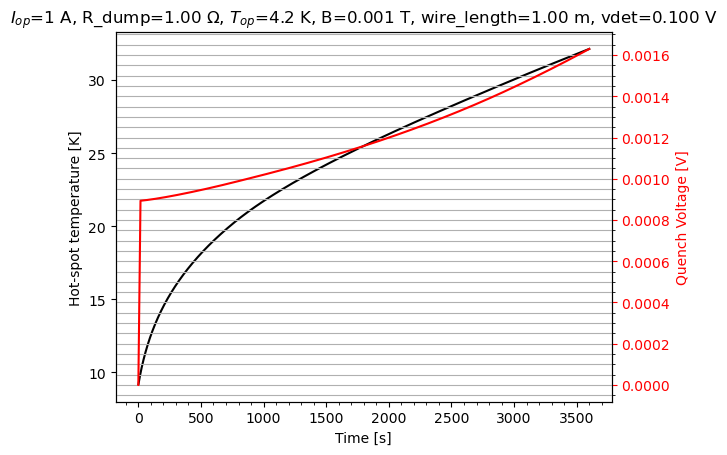

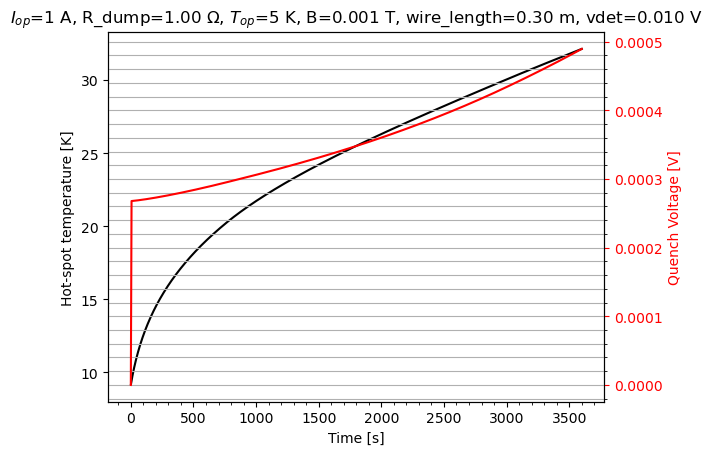

...

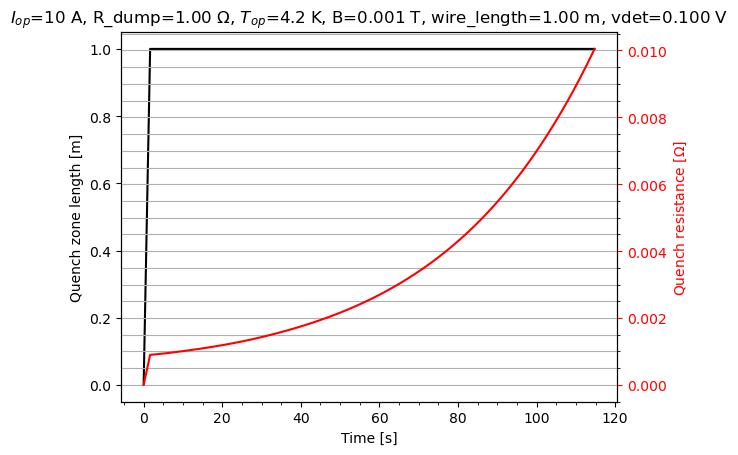

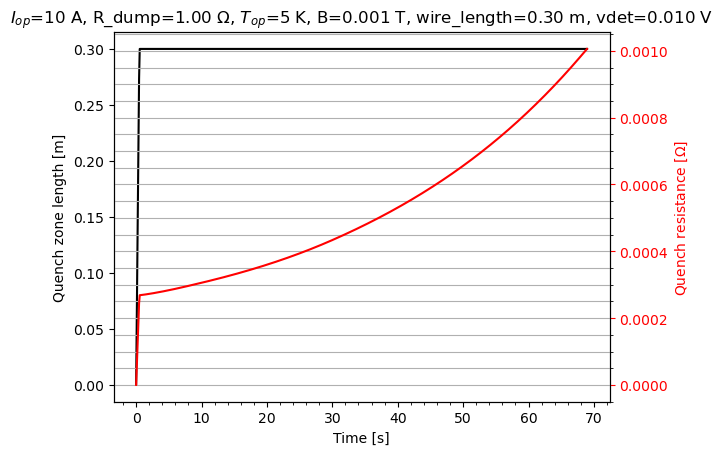

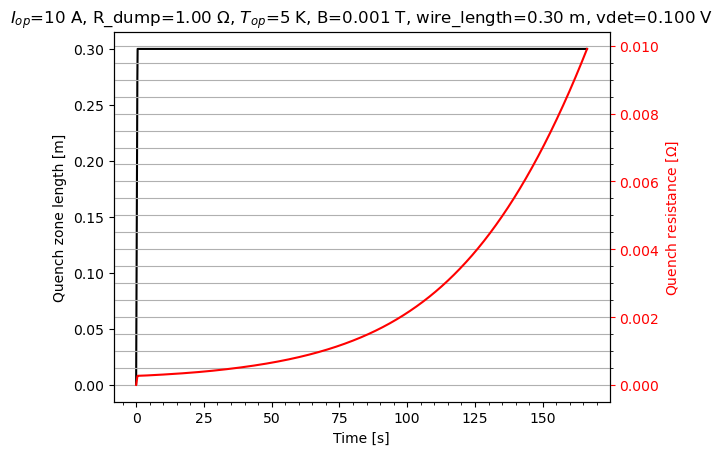

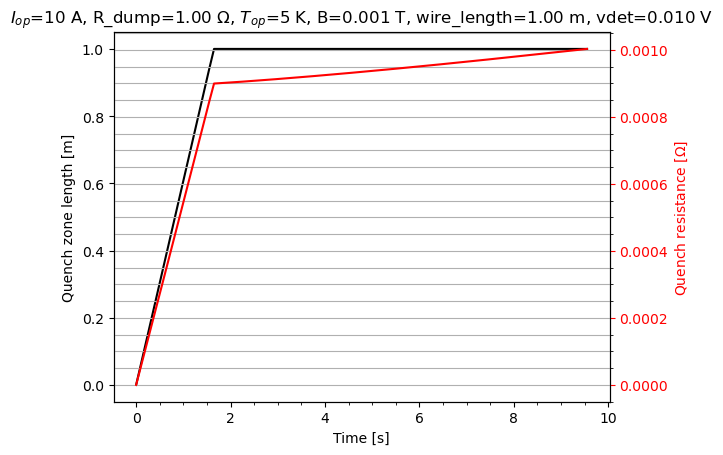

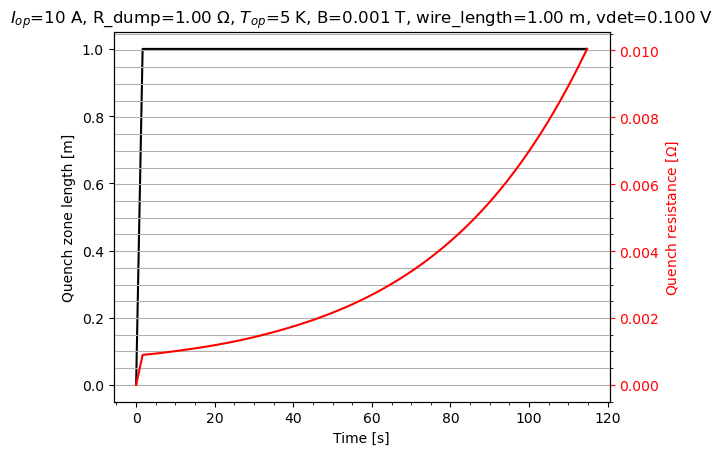

In [7]:
print("************ HIGH RESOLUTION Simulation Results ************")

# plot hot-spot temp and quench voltage
for data in results_high_resolution:
    fig, ax1 = _plt.subplots()
    ax2 = ax1.twinx()
    ax1.plot(data['time_axis'], data['Tmax'], 'k-')
    ax2.plot(data['time_axis'], data['Vq'], 'r-')
    ax1.set_xlabel('Time [s]')
    ax1.set_ylabel('Hot-spot temperature [K]', color='k')
    ax2.set_ylabel('Quench Voltage [V]', color='r')
    #x1.set_ylim([0, 50])
    #ax1.set_xlim([0, 0.125])
    #ax2.set_ylim([0, 0.5])
    ax2.tick_params(axis='y', colors='r')
    _plt.minorticks_on()
    _plt.grid(which='both', axis='both')
    _plt.title(
        '$I_{{op}}$={} A, R_dump={:.2f} $\Omega$, $T_{{op}}$={} K, B={} T, wire_length={:.2f} m, vdet={:.3f} V'.format(
            data['Iop'],
            data['Rdump'],
            data['Top'],
            data['B'],
            data['wire_length'],
            data['vdet']
            )
        )
    _plt.show()

# plot hot-spot temp, average normal zone temperature and normal zone length
for data in results_high_resolution:
    fig, ax1 = _plt.subplots()
    ax2 = ax1.twinx()
    ax1.plot(data['time_axis'], data['Tmax'], 'k-')
    ax1.plot(data['time_axis'], data['Tavg'], 'b--')
    ax2.plot(data['time_axis'], [2 * x for x in data['final_zone_long_radius']], 'r-')
    ax1.set_xlabel('Time [s]')
    ax1.set_ylabel('Hot-spot / average temperature [K]', color='k')
    ax2.set_ylabel('Quench zone length [m]', color='r')
    #x1.set_ylim([0, 50])
    #ax1.set_xlim([0, 0.125])
    #ax2.set_ylim([0, 0.5])
    ax2.tick_params(axis='y', colors='r')
    _plt.minorticks_on()
    _plt.grid(which='both', axis='both')
    _plt.title(
        '$I_{{op}}$={} A, R_dump={:.2f} $\Omega$, $T_{{op}}$={} K, B={} T, wire_length={:.2f} m, vdet={:.3f} V'.format(
            data['Iop'],
            data['Rdump'],
            data['Top'],
            data['B'],
            data['wire_length'],
            data['vdet']
            )
        )
    _plt.show()

# plot dump voltage and current decay
for data in results_high_resolution:
    fig, ax1 = _plt.subplots()
    ax2 = ax1.twinx()
    ax1.plot(data['time_axis'], data['Ve'], 'k-')
    ax2.plot(data['time_axis'], data['I'], 'r-')
    ax1.set_xlabel('Time [s]')
    ax1.set_ylabel('Dump resistor voltage [V]', color='k')
    ax2.set_ylabel('Current [A]', color='r')
    #ax1.set_ylim([0, 310])
    #ax1.set_xlim([0, 0.125])
    #ax2.set_ylim([0, 310])
    ax2.tick_params(axis='y', colors='r')
    _plt.minorticks_on()
    _plt.grid(which='both', axis='both')
    _plt.title(
        '$I_{{op}}$={} A, R_dump={:.2f} $\Omega$, $T_{{op}}$={} K, B={} T, wire_length={:.2f} m, vdet={:.3f} V'.format(
            data['Iop'],
            data['Rdump'],
            data['Top'],
            data['B'],
            data['wire_length'],
            data['vdet']
            )
        )
    _plt.show()

# plot quench zone length and quench resistance
for data in results_high_resolution:
    fig, ax1 = _plt.subplots()
    ax2 = ax1.twinx()
    ax1.plot(data['time_axis'], [2 * x for x in data['final_zone_long_radius']], 'k-')
    ax2.plot(data['time_axis'], data['R'], 'r-')
    ax1.set_xlabel('Time [s]')
    ax1.set_ylabel('Quench zone length [m]', color='k')
    ax2.set_ylabel('Quench resistance [$\Omega$]', color='r')
    ax2.tick_params(axis='y', colors='r')
    #ax1.set_ylim([0, 1.1])
    #ax1.set_xlim([0, 0.125])
    #ax2.set_ylim([0, 0.002])
    _plt.minorticks_on()
    _plt.grid(which='both', axis='both')
    _plt.title(
        '$I_{{op}}$={} A, R_dump={:.2f} $\Omega$, $T_{{op}}$={} K, B={} T, wire_length={:.2f} m, vdet={:.3f} V'.format(
            data['Iop'],
            data['Rdump'],
            data['Top'],
            data['B'],
            data['wire_length'],
            data['vdet']
            )
        )
    _plt.show()

print("************ LOW RESOLUTION Simulation Results ************")

# plot hot-spot temp and quench voltage
for data in results_low_resolution:
    fig, ax1 = _plt.subplots()
    ax2 = ax1.twinx()
    ax1.plot(data['time_axis'], data['Tmax'], 'k-')
    ax2.plot(data['time_axis'], data['Vq'], 'r-')
    ax1.set_xlabel('Time [s]')
    ax1.set_ylabel('Hot-spot temperature [K]', color='k')
    ax2.set_ylabel('Quench Voltage [V]', color='r')
    #ax1.set_ylim([0, 40])
    #ax1.set_xlim([0, 0.125])
    #ax2.set_ylim([0, 0.5])
    ax2.tick_params(axis='y', colors='r')
    _plt.minorticks_on()
    _plt.grid(which='both', axis='both')
    _plt.title(
        '$I_{{op}}$={} A, R_dump={:.2f} $\Omega$, $T_{{op}}$={} K, B={} T, wire_length={:.2f} m, vdet={:.3f} V'.format(
            data['Iop'],
            data['Rdump'],
            data['Top'],
            data['B'],
            data['wire_length'],
            data['vdet']
            )
        )
    _plt.show()

# plot dump voltage and current decay
for data in results_low_resolution:
    fig, ax1 = _plt.subplots()
    ax2 = ax1.twinx()
    ax1.plot(data['time_axis'], data['Ve'], 'k-')
    ax2.plot(data['time_axis'], data['I'], 'r-')
    ax1.set_xlabel('Time [s]')
    ax1.set_ylabel('Dump resistor voltage [V]', color='k')
    ax2.set_ylabel('Current [A]', color='r')
    #ax1.set_ylim([0, 310])
    #ax1.set_xlim([0, 0.125])
    #ax2.set_ylim([0, 310])
    ax2.tick_params(axis='y', colors='r')
    _plt.minorticks_on()
    _plt.grid(which='both', axis='both')
    _plt.title(
        '$I_{{op}}$={} A, R_dump={:.2f} $\Omega$, $T_{{op}}$={} K, B={} T, wire_length={:.2f} m, vdet={:.3f} V'.format(
            data['Iop'],
            data['Rdump'],
            data['Top'],
            data['B'],
            data['wire_length'],
            data['vdet']
            )
        )
    _plt.show()

# plot quench zone length and quench resistance
for data in results_low_resolution:
    fig, ax1 = _plt.subplots()
    ax2 = ax1.twinx()
    ax1.plot(data['time_axis'], [2 * x for x in data['final_zone_long_radius']], 'k-')
    ax2.plot(data['time_axis'], data['R'], 'r-')
    ax1.set_xlabel('Time [s]')
    ax1.set_ylabel('Quench zone length [m]', color='k')
    ax2.set_ylabel('Quench resistance [$\Omega$]', color='r')
    ax2.tick_params(axis='y', colors='r')
    #ax1.set_ylim([0, 1.1])
    #ax1.set_xlim([0, 0.125])
    #ax2.set_ylim([0, 0.002])
    _plt.minorticks_on()
    _plt.grid(which='both', axis='both')
    _plt.title(
        '$I_{{op}}$={} A, R_dump={:.2f} $\Omega$, $T_{{op}}$={} K, B={} T, wire_length={:.2f} m, vdet={:.3f} V'.format(
            data['Iop'],
            data['Rdump'],
            data['Top'],
            data['B'],
            data['wire_length'],
            data['vdet']
            )
        )
    _plt.show()


##### Save data

In [11]:
# Save high resolution data
i = 0
for data in results_high_resolution:
    file_name = 'high_res_{}'.format(i)
    i += 1
    with open(file_name+'.txt', 'w') as f:
        for k in data.keys():
            if type(data[k]) != list:
                f.write('{}, {}\r\n'.format(k, data[k]))
    _np.savetxt(file_name+'_Ve_vs_time.txt', _np.c_[data['time_axis'], data['Ve']], delimiter=', ')
    _np.savetxt(file_name+'_R_vs_time.txt', _np.c_[data['time_axis'], data['R']], delimiter=', ')
    _np.savetxt(file_name+'_I_vs_time.txt', _np.c_[data['time_axis'], data['I']], delimiter=', ')
    _np.savetxt(file_name+'_Vq_vs_time.txt', _np.c_[data['time_axis'], data['Vq']], delimiter=', ')
    _np.savetxt(file_name+'_Vc_vs_time.txt', _np.c_[data['time_axis'], data['Vc']], delimiter=', ')
    _np.savetxt(file_name+'_Vl_vs_time.txt', _np.c_[data['time_axis'], data['Vl']], delimiter=', ')
    _np.savetxt(file_name+'_Vnz_vs_time.txt', _np.c_[data['time_axis'], data['Vnz']], delimiter=', ')
    _np.savetxt(file_name+'_Eq_vs_time.txt', _np.c_[data['time_axis'], data['Eq']], delimiter=', ')
    _np.savetxt(file_name+'_Eps_vs_time.txt', _np.c_[data['time_axis'], data['Eps']], delimiter=', ')
    _np.savetxt(file_name+'_Tmax_vs_time.txt', _np.c_[data['time_axis'], data['Tmax']], delimiter=', ')
    _np.savetxt(file_name+'_Tavg_vs_time.txt', _np.c_[data['time_axis'], data['Tavg']], delimiter=', ')
    _np.savetxt(file_name+'_final_zone_transv_radius_vs_time.txt', _np.c_[data['time_axis'], data['final_zone_transv_radius']], delimiter=', ')
    _np.savetxt(file_name+'_final_zone_long_radius_vs_time.txt', _np.c_[data['time_axis'], data['final_zone_long_radius']], delimiter=', ')

# Save low resolution data
i = 0
for data in results_low_resolution:
    file_name = 'low_res_{}'.format(i)
    i += 1
    with open(file_name+'.txt', 'w') as f:
        for k in data.keys():
            if type(data[k]) != list:
                f.write('{}, {}\r\n'.format(k, data[k]))
    _np.savetxt(file_name+'_Ve_vs_time.txt', _np.c_[data['time_axis'], data['Ve']], delimiter=', ')
    _np.savetxt(file_name+'_R_vs_time.txt', _np.c_[data['time_axis'], data['R']], delimiter=', ')
    _np.savetxt(file_name+'_I_vs_time.txt', _np.c_[data['time_axis'], data['I']], delimiter=', ')
    _np.savetxt(file_name+'_Vq_vs_time.txt', _np.c_[data['time_axis'], data['Vq']], delimiter=', ')
    _np.savetxt(file_name+'_Vc_vs_time.txt', _np.c_[data['time_axis'], data['Vc']], delimiter=', ')
    _np.savetxt(file_name+'_Vl_vs_time.txt', _np.c_[data['time_axis'], data['Vl']], delimiter=', ')
    _np.savetxt(file_name+'_Vnz_vs_time.txt', _np.c_[data['time_axis'], data['Vnz']], delimiter=', ')
    _np.savetxt(file_name+'_Eq_vs_time.txt', _np.c_[data['time_axis'], data['Eq']], delimiter=', ')
    _np.savetxt(file_name+'_Eps_vs_time.txt', _np.c_[data['time_axis'], data['Eps']], delimiter=', ')
    _np.savetxt(file_name+'_Tmax_vs_time.txt', _np.c_[data['time_axis'], data['Tmax']], delimiter=', ')
    _np.savetxt(file_name+'_Tavg_vs_time.txt', _np.c_[data['time_axis'], data['Tavg']], delimiter=', ')
    _np.savetxt(file_name+'_final_zone_transv_radius_vs_time.txt', _np.c_[data['time_axis'], data['final_zone_transv_radius']], delimiter=', ')
    _np.savetxt(file_name+'_final_zone_long_radius_vs_time.txt', _np.c_[data['time_axis'], data['final_zone_long_radius']], delimiter=', ')
